# Super resolution 


## Step 1: Create dataset


In [ ]:
from PIL import Image
import glob
from pathlib import Path
import os
import torch
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
import torch.nn as nn
import torch.optim as optim
from torch.optim import lr_scheduler
import torch.nn.functional as F
import numpy as np
from torchsummary import summary
import copy
import matplotlib.pyplot as plt
import requests
from collections import OrderedDict
from tqdm.auto import tqdm
from torchvision.transforms import ToPILImage
from pylab import imread,subplot,imshow,show
from torch import nn
import time
import torch
from torch import nn
from torch.nn import functional as F
from torchvision import models, transforms

tqdm.pandas()
toPil = ToPILImage()

%matplotlib inline

In [ ]:
def encode_labels(target):
    k = np.zeros((10))
  
    return torch.from_numpy(k)

In [ ]:
import torchvision
from torch.utils.data.dataloader import DataLoader
image = torchvision.datasets.VOCDetection(root='./data',year='2011',image_set='train',download = True, target_transform=encode_labels)

  0%|          | 0/1765686784 [00:00<?, ?it/s]

Extracting ./data/VOCtrainval_25-May-2011.tar to ./data


In [ ]:
!mkdir -p data/high_res_train
!mkdir -p data/low_res_train
!mkdir -p data/high_res_test
!mkdir -p data/low_res_test

In [ ]:
import shutil
shutil.unpack_archive("data/VOCtrainval_25-May-2011.tar", "data")


In [ ]:
!mv data/TrainVal/VOCdevkit/VOC2011/JPEGImages data/Raw_Images

In [ ]:
# shutil.rmtree('data/low_res_train')

In [ ]:
def resize_image(image_path):
    image = Image.open(image_path)
    return image.resize((240, 240)), image.resize((120, 120))

In [ ]:
raw_images_path = Path('data/Raw_Images/')
high_res_train_path = Path('data/high_res_train/')
low_res_train_path = Path('data/low_res_train/')

for filename in tqdm(os.listdir(raw_images_path)[:1200]):
    filepath = os.path.join(raw_images_path, filename)
    img240, img120 = resize_image(filepath)
    img240.save(os.path.join(high_res_train_path, filename)) 
    img120.save(os.path.join(low_res_train_path, filename)) 

  0%|          | 0/1200 [00:00<?, ?it/s]

In [ ]:
import os
files = os.listdir('data/low_res_train')
len(files)

1200

In [ ]:
def move_files(source_path, dest_path, limit):
    for index in tqdm (range(limit)):
        filename = os.listdir(source_path)[index]
        source_file_path = os.path.join(source_path, filename)
        dest_file_path = os.path.join(dest_path, filename)
        os.rename(source_file_path, dest_file_path)

high_res_test_path = Path('data/high_res_test/')
low_res_test_path = Path('data/low_res_test/')

move_files(high_res_train_path, high_res_test_path, 200)
move_files(low_res_train_path, low_res_test_path, 200)

  0%|          | 0/200 [00:00<?, ?it/s]

  0%|          | 0/200 [00:00<?, ?it/s]

In [ ]:
files = os.listdir('data/low_res_test')
len(files)

200

In [ ]:
data_transform = transforms.Compose(
    [
        transforms.ToTensor()
    ])

In [ ]:
class ImageDataSet(Dataset):
    def __init__(self, folders, transform):
        self.folders = folders 
        self.transform = transform
        self.filenames = os.listdir(folders[0])

    def __len__(self):
        return len(self.filenames)

    def __getitem__(self, idx):
        output = {}
        for folder in self.folders:
            image_path = os.path.join(folder, self.filenames[idx])
            image = Image.open(image_path).convert("RGB")
            tensor_image = self.transform(image)
            output[str(folder)[5]] = tensor_image 
        return output 

### Dataloaders

In [ ]:
train_dataset = ImageDataSet([low_res_train_path, high_res_train_path], data_transform)
test_dataset = ImageDataSet([low_res_test_path, high_res_test_path], data_transform)

train_dataloader = DataLoader(train_dataset, batch_size=16, shuffle=True, num_workers=2)
test_dataloader = DataLoader(test_dataset, batch_size=16, shuffle=False, num_workers=2)

### Show images

CPU times: user 56.4 ms, sys: 10.1 ms, total: 66.5 ms
Wall time: 65.6 ms


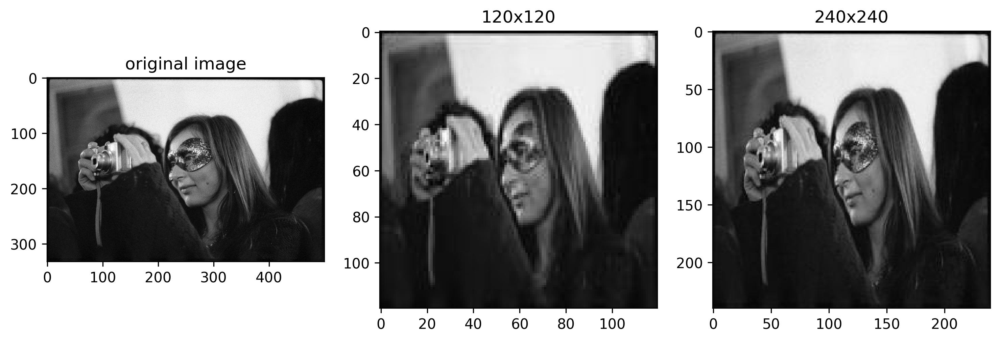

In [ ]:
%%time

image_index = 0
fontsize=12
image = test_dataset.__getitem__(image_index)

# high_image = (image['h'].permute(1, 2, 0).numpy()*255).astype('uint8') 
# low_image =  (image['l'].permute(1, 2, 0).numpy()*255).astype('uint8') 
high_image = (image['h'].permute(1, 2, 0).numpy()) 
low_image =  (image['l'].permute(1, 2, 0).numpy())
plt.figure(figsize=(12,12),dpi=300)

ax = plt.subplot(1, 3, 1)
ax.set_title('original image')

filename = os.listdir(raw_images_path)[image_index]
file_path= os.path.join(raw_images_path, filename)
plt.imshow(imread(file_path))

ax = plt.subplot(1, 3, 2)
ax.set_title('120x120')
plt.imshow(low_image)

ax = plt.subplot(1, 3, 3)
ax.set_title('240x240')
plt.imshow(high_image);



## Step 2: Create initial model

In [ ]:
class SRCNN(nn.Module):
    def __init__(self, num_channels=3):
        super(SRCNN, self).__init__()
        self.conv1 = nn.Conv2d(num_channels, 64, kernel_size=9, padding=9 // 2)
        self.conv2 = nn.Conv2d(64, 32, kernel_size=5, padding=5 // 2)
        self.conv3 = nn.Conv2d(32, num_channels, kernel_size=5, padding=5 // 2)
        self.relu = nn.ReLU(inplace=True)

    def forward(self, x):
        x = self.relu(self.conv1(x))
        x = self.relu(self.conv2(x))
        x = self.conv3(x)
        return x

In [ ]:
torch.cuda.is_available()

True

In [ ]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
device

device(type='cuda', index=0)

In [ ]:
model = SRCNN().to(device)
print(model)

SRCNN(
  (conv1): Conv2d(3, 64, kernel_size=(9, 9), stride=(1, 1), padding=(4, 4))
  (conv2): Conv2d(64, 32, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2))
  (conv3): Conv2d(32, 3, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2))
  (relu): ReLU(inplace=True)
)


In [ ]:
summary(model, (3, 120, 120))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 120, 120]          15,616
              ReLU-2         [-1, 64, 120, 120]               0
            Conv2d-3         [-1, 32, 120, 120]          51,232
              ReLU-4         [-1, 32, 120, 120]               0
            Conv2d-5          [-1, 3, 120, 120]           2,403
Total params: 69,251
Trainable params: 69,251
Non-trainable params: 0
----------------------------------------------------------------
Input size (MB): 0.16
Forward/backward pass size (MB): 21.42
Params size (MB): 0.26
Estimated Total Size (MB): 21.85
----------------------------------------------------------------


## Step 3: Train and eval

In [ ]:
def train(model, dataloader, optimizer, criterion):
    model.train()
    running_loss = 0.0
    running_psnr = 0.0
    for _, data in enumerate(dataloader):
        image_data = data['l'].to(device)
        label = data['h'].to(device)
        optimizer.zero_grad()
        upsample = torch.nn.Upsample(scale_factor=2, mode='bilinear')
        outputs = model(upsample(image_data))
        loss = criterion(outputs, label)
        loss.backward()
        optimizer.step()
        running_loss += loss.item()
    final_loss = running_loss/len(dataloader.dataset)
    return final_loss

In [ ]:
def validate(model, dataloader, criterion):
    model.eval()
    running_loss = 0.0
    running_psnr = 0.0
    with torch.no_grad():
        for _, data in enumerate(dataloader):
            image_data = data['l'].to(device)
            label = data['h'].to(device)
            upsample = torch.nn.Upsample(scale_factor=2, mode='bilinear')
            outputs = model(upsample(image_data))
            loss = criterion(outputs, label)
            running_loss += loss.item()
    final_loss = running_loss/len(dataloader.dataset)
    return final_loss

In [ ]:
%%time
def evaluate(model, train_dataloader, test_dataloader, optimizer, criterion, epochs = 30):
  train_loss, val_loss = [], []
  start = time.time()

  for epoch in tqdm(range(epochs)):
      print(f"Running epoch #{epoch + 1} out of {epochs}")
      train_epoch_loss = train(model, train_dataloader, optimizer, criterion)
      val_epoch_loss = validate(model, test_dataloader, criterion)
      print(f"Train loss: {train_epoch_loss:.3f}")
      print(f"Val loss: {val_epoch_loss:.3f}")
      train_loss.append(train_epoch_loss)
      val_loss.append(val_epoch_loss)
  end = time.time()
  print(f"Finished training in: {((end-start)/60):.3f} minutes")
  return train_loss, val_loss

CPU times: user 7 µs, sys: 0 ns, total: 7 µs
Wall time: 26.9 µs


In [ ]:
import warnings
warnings.filterwarnings('ignore')

def plot_samples(model, test_dataloader, device='cpu:0'):
    images = iter(test_dataloader).next()
    X, y = images['l'], images['h']
    model = model.to(device)
    model.eval()
    upsample = torch.nn.Upsample(scale_factor=2, mode='bilinear')
    outputs = model(upsample(X.to(device)))

    if isinstance(outputs,torch.Tensor):
        outputs = [outputs]

    cols = ['input (120x120)', 'target (240x240)', 'output (240x240))']
    fig, axes = plt.subplots(nrows=len(X), ncols=3, figsize=(30, 100))

    for i, axs in enumerate(axes):
        axs[0].imshow(X[i].permute(1,2,0))
        axs[1].imshow((y[i].permute(1, 2, 0).numpy()*255).astype('uint8') )
        axs[2].imshow(outputs[0][i].permute(1,2,0).cpu().detach())

        if i == 0:
            for ax, col in zip(axs, cols):
                ax.set_title(col, fontsize=30)

    fig.tight_layout()
    plt.show();

### MSE Loss

In [ ]:
train_dataloader = DataLoader(train_dataset, batch_size=16, shuffle=True, num_workers=2)
test_dataloader = DataLoader(test_dataset, batch_size=16, shuffle=False, num_workers=2)
model = SRCNN().to(device)

In [ ]:
%%time

optimizer = optim.Adam(model.parameters(), lr=0.003)
criterion = nn.MSELoss()
mse_train_loss, mse_val_loss = evaluate(model, train_dataloader, test_dataloader, optimizer, criterion, epochs = 30)

  0%|          | 0/30 [00:00<?, ?it/s]

Running epoch #1 out of 30
Train loss: 0.006
Val loss: 0.001
Running epoch #2 out of 30
Train loss: 0.001
Val loss: 0.001
Running epoch #3 out of 30
Train loss: 0.001
Val loss: 0.001
Running epoch #4 out of 30
Train loss: 0.001
Val loss: 0.001
Running epoch #5 out of 30
Train loss: 0.001
Val loss: 0.001
Running epoch #6 out of 30
Train loss: 0.001
Val loss: 0.001
Running epoch #7 out of 30
Train loss: 0.001
Val loss: 0.001
Running epoch #8 out of 30
Train loss: 0.001
Val loss: 0.001
Running epoch #9 out of 30
Train loss: 0.001
Val loss: 0.001
Running epoch #10 out of 30
Train loss: 0.001
Val loss: 0.001
Running epoch #11 out of 30
Train loss: 0.001
Val loss: 0.001
Running epoch #12 out of 30
Train loss: 0.001
Val loss: 0.001
Running epoch #13 out of 30
Train loss: 0.001
Val loss: 0.001
Running epoch #14 out of 30
Train loss: 0.001
Val loss: 0.001
Running epoch #15 out of 30
Train loss: 0.001
Val loss: 0.001
Running epoch #16 out of 30
Train loss: 0.001
Val loss: 0.001
Running epoch #17

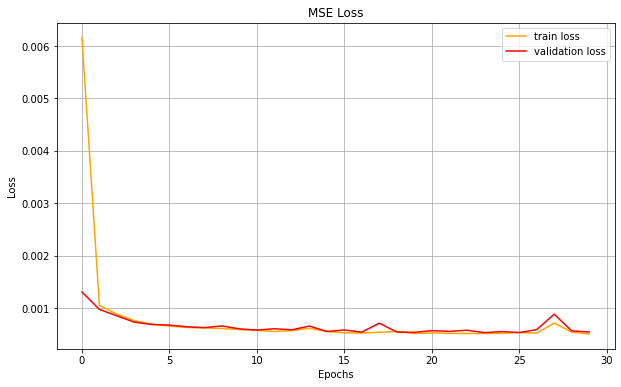

In [ ]:
plt.figure(figsize=(10, 6))
plt.plot(mse_train_loss, color='orange', label='train loss')
plt.plot(mse_val_loss, color='red', label='validation loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.grid()
plt.title('MSE Loss')
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

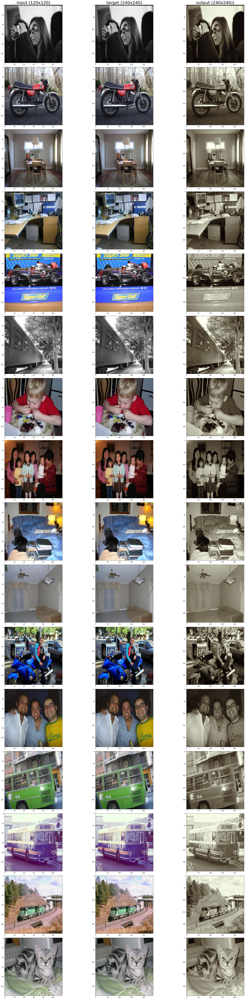

CPU times: user 15.5 s, sys: 496 ms, total: 16 s
Wall time: 16 s


In [ ]:
%%time
plot_samples(model, test_dataloader)

### VGG Perceptual loss

In [ ]:
class Lambda(nn.Module):
    def __init__(self, func):
        super().__init__()
        object.__setattr__(self, 'forward', func)

    def extra_repr(self):
        return getattr(self.forward, '__name__', type(self.forward).__name__) + '()'

class WeightedLoss(nn.ModuleList):
    def __init__(self, losses, weights, verbose=False):
        super().__init__()
        for loss in losses:
            self.append(loss if isinstance(loss, nn.Module) else Lambda(loss))
        self.weights = weights
        self.verbose = verbose

    def _print_losses(self, losses):
        for i, loss in enumerate(losses):
            print(f'({i}) {type(self[i]).__name__}: {loss.item()}')

    def forward(self, *args, **kwargs):
        losses = []
        for loss, weight in zip(self, self.weights):
            losses.append(loss(*args, **kwargs) * weight)
        if self.verbose:
            self._print_losses(losses)
        return sum(losses)

class VGGLoss(nn.Module):
    models = {'vgg16': models.vgg16, 'vgg19': models.vgg19}

    def __init__(self, model='vgg16', layer=8, shift=0, reduction='mean'):
        super().__init__()
        self.shift = shift
        self.reduction = reduction
        self.normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                              std=[0.229, 0.224, 0.225])
        self.model = self.models[model](pretrained=True).features[:layer+1]
        self.model.eval()
        self.model.requires_grad_(False)

    def get_features(self, input):
        return self.model(self.normalize(input))

    def train(self, mode=True):
        self.training = mode

    def forward(self, input, target, target_is_features=False):
        if target_is_features:
            input_feats = self.get_features(input)
            target_feats = target
        else:
            sep = input.shape[0]
            batch = torch.cat([input, target])
            if self.shift and self.training:
                padded = F.pad(batch, [self.shift] * 4, mode='replicate')
                batch = transforms.RandomCrop(batch.shape[2:])(padded)
            feats = self.get_features(batch)
            input_feats, target_feats = feats[:sep], feats[sep:]
        return F.mse_loss(input_feats, target_feats, reduction=self.reduction)

In [ ]:
train_dataloader = DataLoader(train_dataset, batch_size=16, shuffle=True, num_workers=2)
test_dataloader = DataLoader(test_dataset, batch_size=16, shuffle=False, num_workers=2)
model = SRCNN().to(device)

In [ ]:
%%time

optimizer = optim.Adam(model.parameters(), lr=0.003)
criterion = WeightedLoss([VGGLoss(), nn.MSELoss()], [1, 1]).to(device)
mse_vgg_train_loss, mse_vgg_val_loss = evaluate(model, train_dataloader, test_dataloader, optimizer, criterion, epochs = 30)

  0%|          | 0/30 [00:00<?, ?it/s]

Running epoch #1 out of 30
Train loss: 0.267
Val loss: 0.225
Running epoch #2 out of 30
Train loss: 0.208
Val loss: 0.210
Running epoch #3 out of 30
Train loss: 0.199
Val loss: 0.206
Running epoch #4 out of 30
Train loss: 0.195
Val loss: 0.204
Running epoch #5 out of 30
Train loss: 0.193
Val loss: 0.198
Running epoch #6 out of 30
Train loss: 0.190
Val loss: 0.198
Running epoch #7 out of 30
Train loss: 0.189
Val loss: 0.198
Running epoch #8 out of 30
Train loss: 0.186
Val loss: 0.195
Running epoch #9 out of 30
Train loss: 0.185
Val loss: 0.195
Running epoch #10 out of 30
Train loss: 0.184
Val loss: 0.196
Running epoch #11 out of 30
Train loss: 0.182
Val loss: 0.195
Running epoch #12 out of 30
Train loss: 0.183
Val loss: 0.190
Running epoch #13 out of 30
Train loss: 0.181
Val loss: 0.191
Running epoch #14 out of 30
Train loss: 0.180
Val loss: 0.188
Running epoch #15 out of 30
Train loss: 0.179
Val loss: 0.191
Running epoch #16 out of 30
Train loss: 0.179
Val loss: 0.190
Running epoch #17

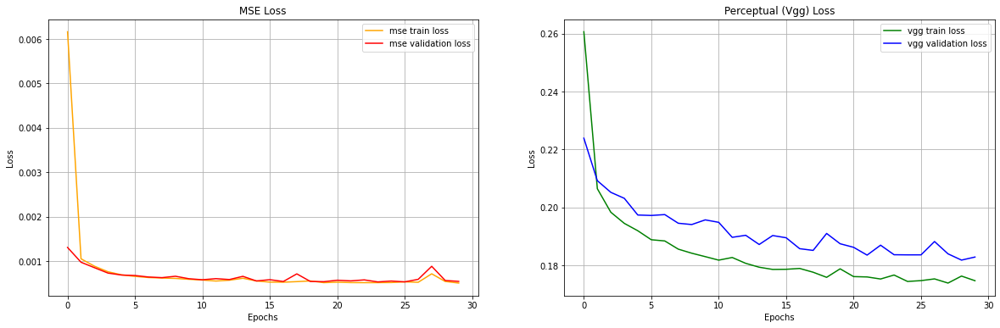

In [ ]:
plt.figure(figsize=(20, 6))

ax = plt.subplot(1, 2, 1)
ax.set_title('MSE Loss')
plt.plot(mse_train_loss, color='orange', label='mse train loss')
plt.plot(mse_val_loss, color='red', label='mse validation loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.grid()

ax = plt.subplot(1, 2, 2)
ax.set_title('Perceptual (Vgg) Loss')
plt.plot(np.array(mse_vgg_train_loss) - np.array(mse_train_loss), color='green', label='vgg train loss')
plt.plot(np.array(mse_vgg_val_loss) - np.array(mse_val_loss), color='blue', label='vgg validation loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.grid()

plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

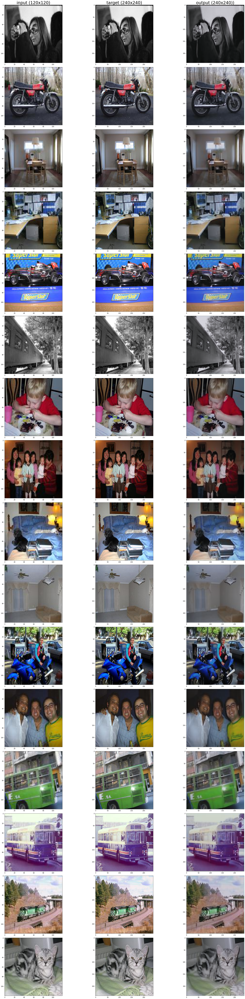

CPU times: user 15.7 s, sys: 509 ms, total: 16.3 s
Wall time: 16.2 s


In [ ]:
%%time
plot_samples(model, test_dataloader)

## Step 4: Summary
We can see from the plots above that the perceptual loss from VGG is much more significant than the MSE loss. Hence, the images coming from the model trained  with the VGG loss look definitely better than the images from the model trained only with MSE loss.